In [1]:
import pandas as pd
import cv2
import matplotlib.pyplot as plt


In [2]:
df0df = pd.read_csv("../result/deepface_analysis_results_0.csv")
df1df = pd.read_csv("../result/deepface_analysis_results_1.csv")
df2df = pd.read_csv("../result/deepface_analysis_results_2.csv")
df3df = pd.read_csv("../result/deepface_analysis_results_3.csv")
df4df = pd.read_csv("../result/deepface_analysis_results_4.csv")


In [3]:
df0df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 70 entries, 0 to 69
Data columns (total 11 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   age               70 non-null     int64  
 1   region            70 non-null     object 
 2   face_confidence   70 non-null     float64
 3   gender            70 non-null     object 
 4   dominant_gender   70 non-null     object 
 5   race              70 non-null     object 
 6   dominant_race     70 non-null     object 
 7   emotion           70 non-null     object 
 8   dominant_emotion  70 non-null     object 
 9   file_path         70 non-null     object 
 10  face_number       70 non-null     int64  
dtypes: float64(1), int64(2), object(8)
memory usage: 6.1+ KB


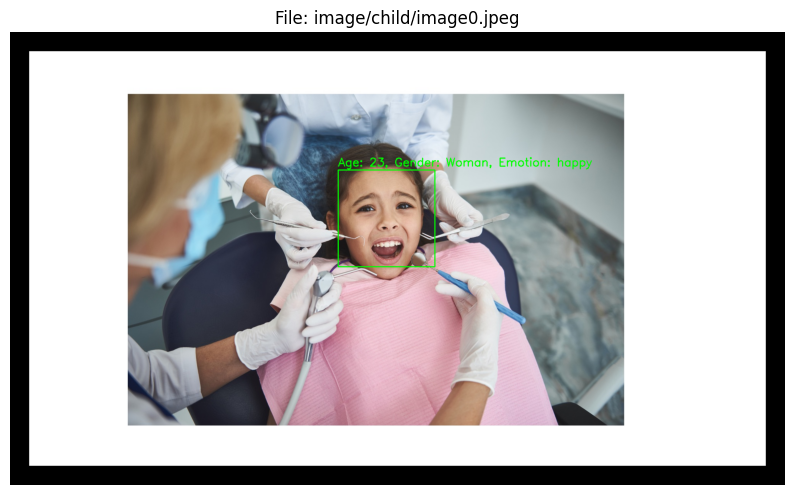

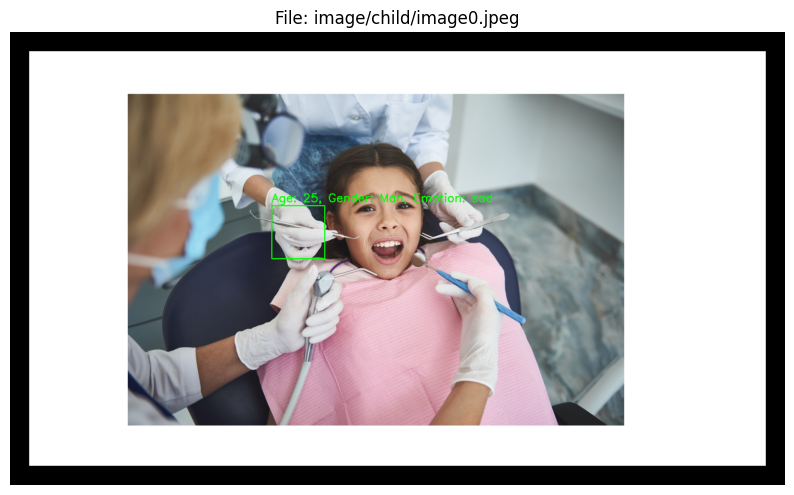

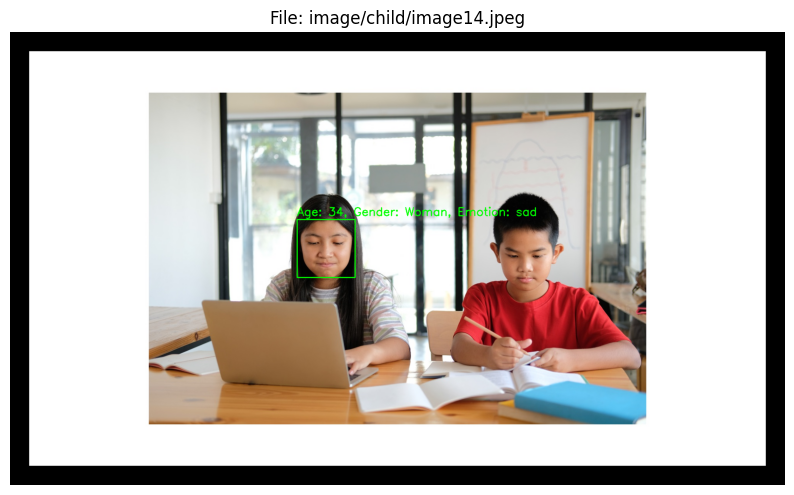

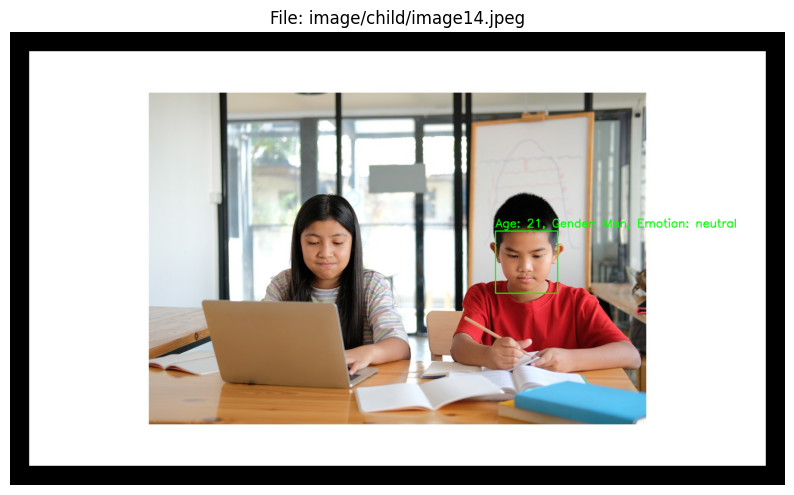

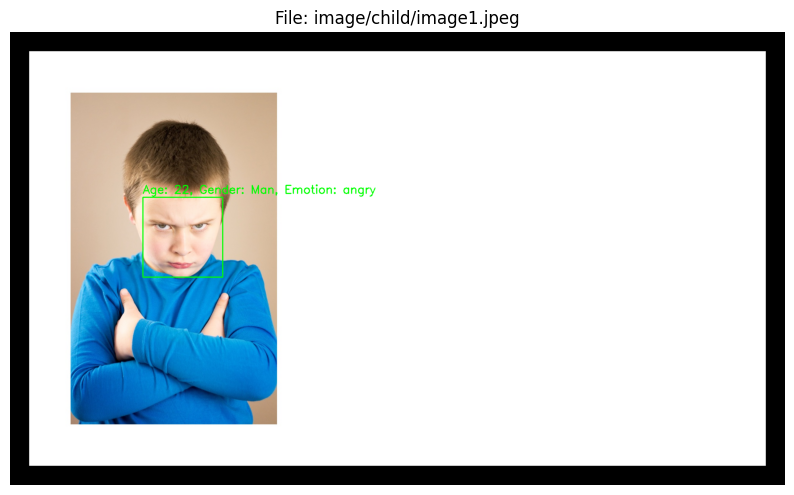

...

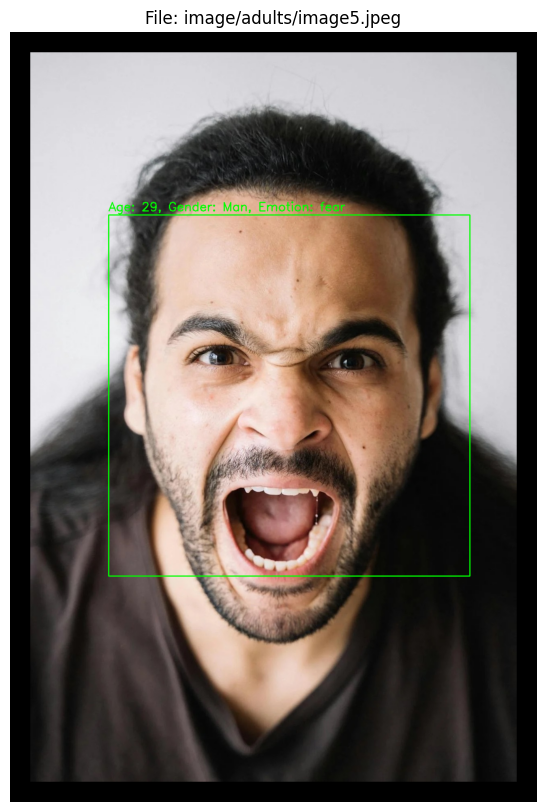

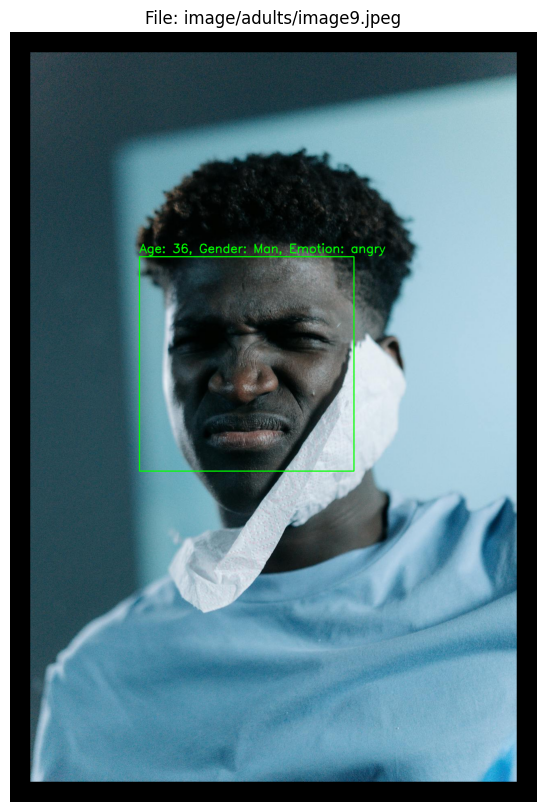

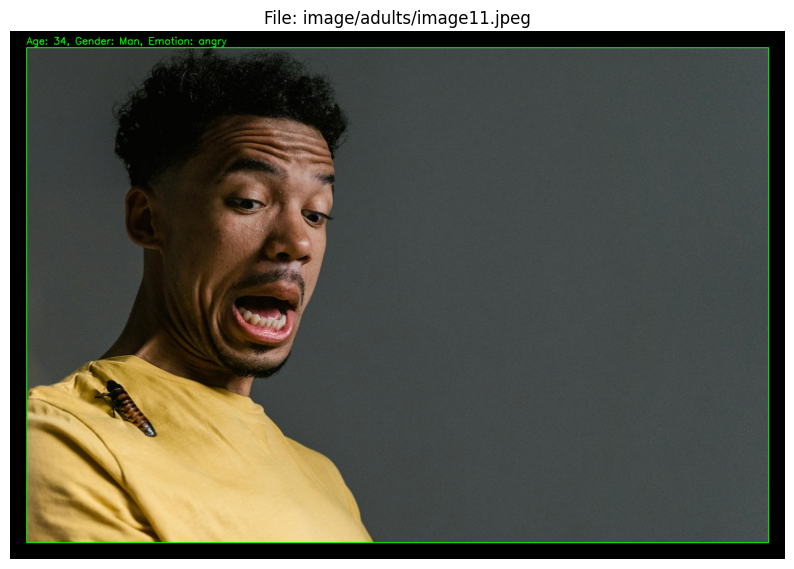

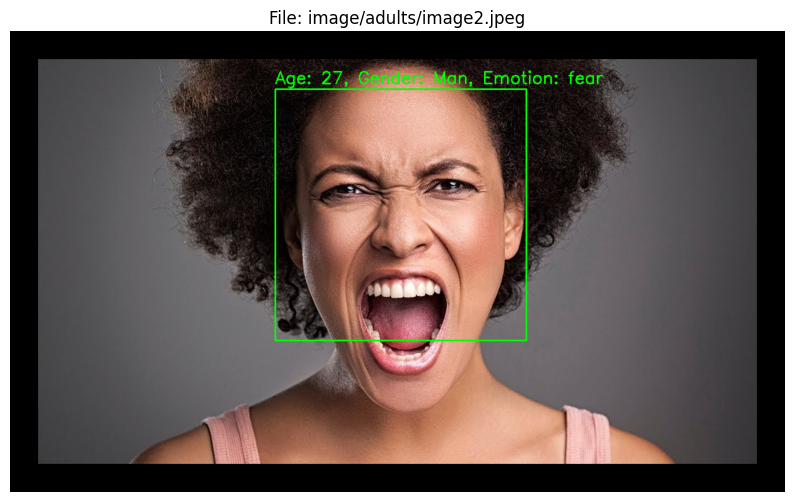

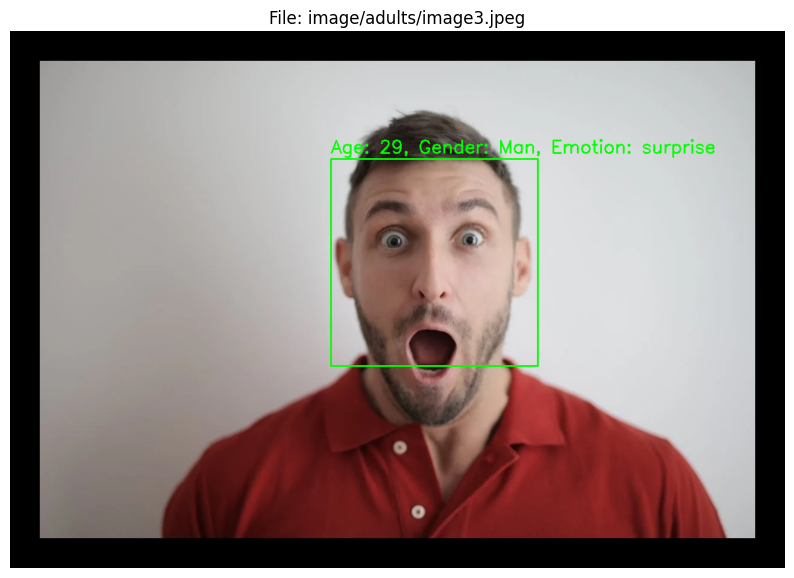

In [4]:
# Iterate over each row in the DataFrame
for index, row in df0df.iterrows():
    # Read the image
    image = cv2.imread(f"../{row['file_path']}")

    # Check if the image is read correctly
    if image is not None:
        # Convert the image from BGR to RGB for correct color display
        image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

        # Create a larger canvas with extra space around the image
        top, bottom, left, right = [50] * 4  # Adjust the padding as needed
        color = [0, 0, 0]  # Black padding color
        image_with_border = cv2.copyMakeBorder(image_rgb, top, bottom, left, right, cv2.BORDER_CONSTANT, value=color)

        # Update region coordinates for the new image
        region = eval(row['region'])  # Convert string representation of dict to a dict
        x, y, w, h = region['x'] + left, region['y'] + top, region['w'], region['h']

        # Draw rectangle around the face
        cv2.rectangle(image_with_border, (x, y), (x + w, y + h), (0, 255, 0), 2)

        # Prepare text information
        age = row['age']
        gender = row['dominant_gender']
        emotion = row['dominant_emotion']
        file_path = row['file_path']

        text = f"Age: {age}, Gender: {gender}, Emotion: {emotion}"

        # Calculate position for text
        text_x, text_y = x, y - 10
        if text_y < 10:  # Ensure text is not out of the image bounds
            text_y = y + h + 20

        # Put text above or below the rectangle
        cv2.putText(image_with_border, text, (text_x, text_y), cv2.FONT_HERSHEY_SIMPLEX, 1.0, (0, 255, 0), 2)

        # Display the image with Matplotlib
        plt.figure(figsize=(10, 10))
        plt.imshow(image_with_border)
        plt.title(f"File: {file_path}")
        plt.axis('off')  # Hide axis
        plt.show()
    else:
        print(f"Error reading image at path: ../{row['file_path']}")

In [5]:
# selected_col = ["dominant_gender", "dominant_emotion", "file_path"]

In [6]:
# df0df = df0df[selected_col]
# df1df = df1df[selected_col]
# df2df = df2df[selected_col]
# df3df = df3df[selected_col]
# df4df = df4df[selected_col]

In [7]:
# Checking computer error.
# Check if the data has different value